# San Francisco Fire Data - Plotly Experimentation
[**SF Fire Data (Incidents, Violations, and more)**](https://www.kaggle.com/san-francisco/sf-fire-data-incidents-violations-and-more)

Messing around with plotly visualization and ipywidgets

---

In [24]:
import os
import pandas as pd
import numpy as np
import re
import ipywidgets as widgets
import matplotlib.pyplot as plt
import seaborn as sns
from pylab import rcParams
%matplotlib inline

pd.options.display.max_columns = 40
sns.set(style='darkgrid', font_scale=1.5)
rcParams['figure.figsize'] = 14, 8

## EDA

In [11]:
data = pd.read_csv('../../../data/sf-fires-data/fire-department-calls-for-service.csv',
                   low_memory=False)

In [12]:
data.columns = [i.lower().replace(' ', '_') for i in data.columns]

In [13]:
for i in data.columns:
    if 'date' in i or 'dttm' in i:
        print(i)
        data[i] = pd.to_datetime(data[i])

call_date
watch_date
received_dttm
entry_dttm
dispatch_dttm
response_dttm
on_scene_dttm
transport_dttm
hospital_dttm
available_dttm


In [14]:
data.shape

(4833539, 34)

In [15]:
data.head()

,call_number,unit_id,incident_number,call_type,call_date,watch_date,received_dttm,entry_dttm,dispatch_dttm,response_dttm,on_scene_dttm,transport_dttm,hospital_dttm,call_final_disposition,available_dttm,address,city,zipcode_of_incident,battalion,station_area,box,original_priority,priority,final_priority,als_unit,call_type_group,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhooods_-_analysis_boundaries,location,rowid
0,1030101,E18,306091,Medical Incident,2000-04-12,2000-04-12 21:01:40,2000-04-12 21:00:29,2000-04-12 21:01:40,2000-04-12 21:02:00,NaT,NaT,NaT,NaT,Other,NaT,2000 Block of 37TH AVE,SF,94116.0,B08,18,0757,3,3,3,False,NaN,1,ENGINE,1.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7487...",001030101-E18
1,1030104,M14,30612,Medical Incident,2000-04-12,2000-04-12 21:10:17,2000-04-12 21:09:02,2000-04-12 21:10:17,2000-04-12 21:10:29,2000-04-12 21:12:11,2000-04-12 21:19:36,2000-04-12 21:43:57,2000-04-12 22:03:33,Other,2000-04-12 22:23:57,1700 Block of 43RD AVE,SF,94122.0,B08,23,7651,3,3,3,True,NaN,1,MEDIC,2.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7540...",001030104-M14
2,1030106,M36,30614,Medical Incident,2000-04-12,2000-04-12 21:10:56,2000-04-12 21:09:44,2000-04-12 21:10:56,2000-04-12 21:11:47,NaT,2000-04-12 21:14:11,2000-04-12 21:59:31,2000-04-12 22:10:06,Other,2000-04-12 22:43:40,0 Block of FELL ST,SF,94102.0,B02,36,3111,3,3,3,False,NaN,1,MEDIC,1.0,2,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7764...",001030106-M36
3,1030107,E01,30615,Alarms,2000-04-12,2000-04-12 21:13:51,2000-04-12 21:13:47,2000-04-12 21:13:51,2000-04-12 21:14:13,2000-04-12 21:15:58,2000-04-12 21:20:12,NaT,NaT,Other,2000-04-12 21:24:19,100 Block of JONES ST,SF,94102.0,B03,01,1456,3,3,3,False,NaN,1,ENGINE,3.0,3,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7825...",001030107-E01
4,1030108,RS1,30616,Medical Incident,2000-04-12,2000-04-12 21:16:11,2000-04-12 21:14:43,2000-04-12 21:16:11,2000-04-12 21:16:24,2000-04-12 21:18:20,2000-04-12 21:20:08,NaT,NaT,Other,2000-04-12 21:20:36,700 Block of MARKET ST,SF,94108.0,B03,01,1322,3,3,3,False,NaN,1,RESCUE SQUAD,2.0,1,3,Financial District/South Beach,"{'needs_recoding': False, 'latitude': '37.7863...",001030108-RS1


In [16]:
pd.DataFrame(np.transpose([data.dtypes.values, data.isnull().sum().values]),
             index=data.columns, columns=['dtype', 'isnull'])

,dtype,isnull
call_number,int64,0
unit_id,object,0
incident_number,int64,0
call_type,object,0
call_date,datetime64[ns],0
watch_date,datetime64[ns],0
received_dttm,datetime64[ns],0
entry_dttm,datetime64[ns],0
dispatch_dttm,datetime64[ns],0
response_dttm,datetime64[ns],406644


In [17]:
data.describe(include='all')

,call_number,unit_id,incident_number,call_type,call_date,watch_date,received_dttm,entry_dttm,dispatch_dttm,response_dttm,on_scene_dttm,transport_dttm,hospital_dttm,call_final_disposition,available_dttm,address,city,zipcode_of_incident,battalion,station_area,box,original_priority,priority,final_priority,als_unit,call_type_group,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhooods_-_analysis_boundaries,location,rowid
count,4.833539e+06,4833539,4.833539e+06,4833539,4833539,4833539,4833539,4833539,4833539,4426895,3724004,1266584,1133128,4833539,4756660,4833539,4826266,4.819509e+06,4833539,4831214,4833110,4808010,4833536,4.833539e+06,4833539,2028969,4.833539e+06,4833539,4.833476e+06,4833539,4833539,4833539,4833539,4833539
unique,NaN,749,NaN,32,6822,696153,2179339,2179796,2355127,4373886,3684256,1264998,1131478,15,4462087,29776,27,NaN,14,53,2251,8,8,NaN,2,4,NaN,10,NaN,11,12,42,65447,4833539
top,NaN,E03,NaN,Medical Incident,2017-09-02 00:00:00,2017-09-01 00:00:00,2016-06-18 14:19:13,2016-06-18 14:19:40,2011-12-22 11:54:25,2017-02-24 12:04:50,2014-08-26 00:45:04,2010-05-21 09:10:34,2006-10-02 17:02:06,Other,2014-09-04 16:54:29,0 Block of 6TH ST,SF,NaN,B03,01,2251,3,3,NaN,True,Potentially Life-Threatening,NaN,ENGINE,NaN,2,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7776...",101860251-E19
freq,NaN,161167,NaN,3141592,1741,1826,83,83,79,14,25,4,4,2521323,42,29368,3351970,NaN,839681,633503,53937,3647861,3620129,NaN,2992187,985955,NaN,1859771,NaN,909252,1324150,635633,16940,1
first,NaN,NaN,NaN,NaN,2000-04-12 00:00:00,2000-04-12 00:02:25,2000-04-12 21:00:29,2000-04-12 21:01:40,2000-04-12 21:02:00,2000-04-12 21:11:51,2000-04-12 21:14:11,2000-04-12 21:38:18,2000-04-12 21:48:13,NaN,2000-04-12 21:20:36,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,NaN,NaN,NaN,NaN,2018-12-15 00:00:00,2018-12-15 00:00:00,2018-12-15 23:58:01,2018-12-15 23:58:01,2018-12-15 23:58:31,2018-12-15 23:58:40,2018-12-16 00:23:00,2018-12-16 00:23:43,2018-12-16 00:41:33,NaN,2018-12-16 01:31:15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,9.893284e+07,NaN,9.769753e+06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.411352e+04,NaN,NaN,NaN,NaN,NaN,2.792744e+00,NaN,NaN,1.005633e+00,NaN,2.174102e+00,NaN,NaN,NaN,NaN,NaN
std,5.415960e+07,NaN,5.425093e+06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.017665e+01,NaN,NaN,NaN,NaN,NaN,4.053407e-01,NaN,NaN,1.017721e-01,NaN,2.161779e+00,NaN,NaN,NaN,NaN,NaN
min,1.030101e+06,NaN,3.061200e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.410200e+04,NaN,NaN,NaN,NaN,NaN,2.000000e+00,NaN,NaN,1.000000e+00,NaN,1.000000e+00,NaN,NaN,NaN,NaN,NaN
25%,5.206022e+07,NaN,5.055014e+06,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,9.410400e+04,NaN,NaN,NaN,NaN,NaN,3.000000e+00,NaN,NaN,1.000000e+00,NaN,1.000000e+00,NaN,NaN,NaN,NaN,NaN


#### Call Type

In [18]:
call_types = data[['call_number', 'call_type']].drop_duplicates()

In [19]:
# check to see if each call number is only associated with ONE call type
call_types.call_number.value_counts()[0:5]

91510263    1
22610315    1
22940010    1
51170009    1
22950253    1
Name: call_number, dtype: int64

In [20]:
call_types.call_type.value_counts()

Medical Incident                                1570898
Alarms                                           174840
Structure Fire                                   149456
Traffic Collision                                 70977
Citizen Assist / Service Call                     58030
Other                                             56263
Outside Fire                                      38476
Electrical Hazard                                 11707
Elevator / Escalator Rescue                       11246
Vehicle Fire                                      10716
Gas Leak (Natural and LP Gases)                    9102
Smoke Investigation (Outside)                      7525
Odor (Strange / Unknown)                           4493
Fuel Spill                                         4260
Water Rescue                                       1985
HazMat                                              876
Assist Police                                       756
Industrial Accidents                            

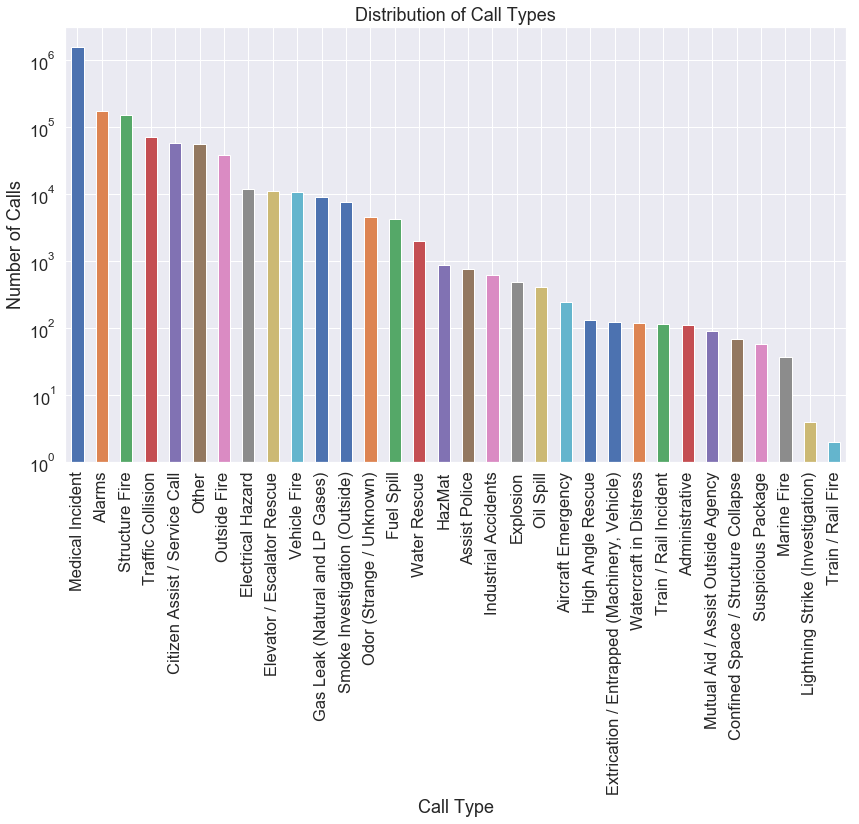

In [25]:
call_types.call_type.value_counts().plot(kind='bar')
plt.title('Distribution of Call Types')
plt.ylabel('Number of Calls')
plt.xlabel('Call Type')
plt.yscale('log')

#### Time of Year

In [26]:
call_dates = data[['call_number', 'call_date']].drop_duplicates()

In [27]:
call_dates.call_number.value_counts()[0:5]

91510263    1
22610315    1
22940010    1
51170009    1
22950253    1
Name: call_number, dtype: int64

In [28]:
month_map = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

In [29]:
call_dates['month'] = call_dates.call_date.dt.month.map(month_map)

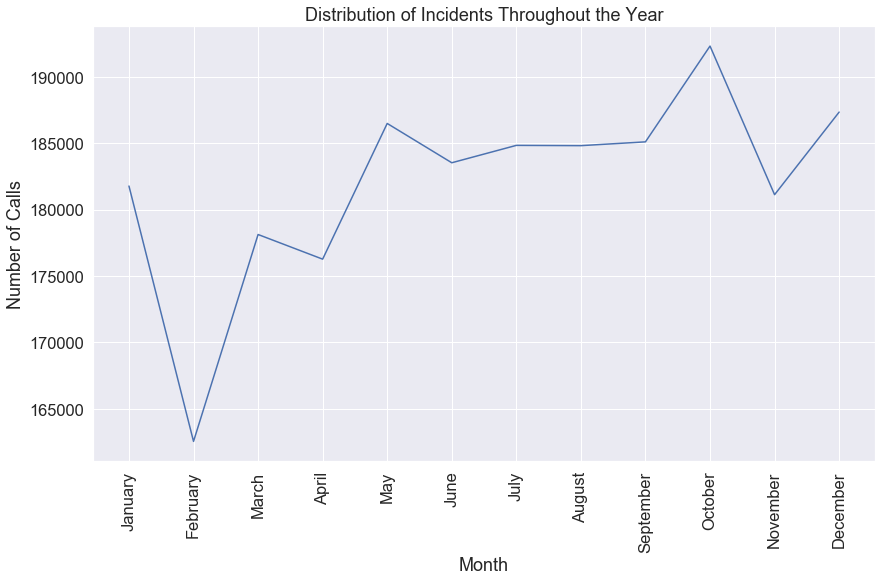

In [30]:
fig1 = pd.DataFrame(call_dates.month.value_counts()).loc[list((map(month_map.get, range(1, 13))))]
plt.plot(fig1.index, fig1.month)
plt.title('Distribution of Incidents Throughout the Year')
plt.ylabel('Number of Calls')
plt.xlabel('Month')
plt.xticks(rotation=90)
plt.show()

In [31]:
# calls per month, year

In [32]:
calls_per_month = call_dates['call_date'].groupby([call_dates.call_date.dt.year, call_dates.call_date.dt.month]
                                                 ).agg('count').to_frame()
calls_per_month['date'] = calls_per_month.index
calls_per_month.date = pd.to_datetime(calls_per_month.date, format='(%Y, %m)')
calls_per_month = calls_per_month.reset_index(drop=True)
calls_per_month.columns = ['num_calls', 'month']

In [33]:
calls_per_month.head()

,num_calls,month
0,5129,2000-04-01
1,8890,2000-05-01
2,8919,2000-06-01
3,8894,2000-07-01
4,9136,2000-08-01


In [34]:
# import plotly
import plotly.plotly as py
import plotly.graph_objs as go

# these two lines are what allow your code to show up in a notebook!
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode()

mapbox_access_token = 'pk.eyJ1IjoidGtoNTA0NCIsImEiOiJjanB1MnppNHowY2h4NDhxem1wYzQ0YnNvIn0.nVJ3ydUD6wePxdrWL8dvqA'

In [35]:
# sepcify that we want a scatter plot with, with date on the x axis and meet on the y axis
fig_data = [go.Scatter(x=calls_per_month.month,
                       y=calls_per_month.num_calls)]

# specify the layout of our figure
layout = go.Layout(title = "Number of Calls per Month",
                   xaxis = dict(title='Date',
                                ticklen=5,
                                zeroline=False))

# create and show our figure
fig = dict(data = fig_data,
           layout = layout)
iplot(fig)

#### Location

In [36]:
data.head()

,call_number,unit_id,incident_number,call_type,call_date,watch_date,received_dttm,entry_dttm,dispatch_dttm,response_dttm,on_scene_dttm,transport_dttm,hospital_dttm,call_final_disposition,available_dttm,address,city,zipcode_of_incident,battalion,station_area,box,original_priority,priority,final_priority,als_unit,call_type_group,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhooods_-_analysis_boundaries,location,rowid
0,1030101,E18,306091,Medical Incident,2000-04-12,2000-04-12 21:01:40,2000-04-12 21:00:29,2000-04-12 21:01:40,2000-04-12 21:02:00,NaT,NaT,NaT,NaT,Other,NaT,2000 Block of 37TH AVE,SF,94116.0,B08,18,0757,3,3,3,False,NaN,1,ENGINE,1.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7487...",001030101-E18
1,1030104,M14,30612,Medical Incident,2000-04-12,2000-04-12 21:10:17,2000-04-12 21:09:02,2000-04-12 21:10:17,2000-04-12 21:10:29,2000-04-12 21:12:11,2000-04-12 21:19:36,2000-04-12 21:43:57,2000-04-12 22:03:33,Other,2000-04-12 22:23:57,1700 Block of 43RD AVE,SF,94122.0,B08,23,7651,3,3,3,True,NaN,1,MEDIC,2.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7540...",001030104-M14
2,1030106,M36,30614,Medical Incident,2000-04-12,2000-04-12 21:10:56,2000-04-12 21:09:44,2000-04-12 21:10:56,2000-04-12 21:11:47,NaT,2000-04-12 21:14:11,2000-04-12 21:59:31,2000-04-12 22:10:06,Other,2000-04-12 22:43:40,0 Block of FELL ST,SF,94102.0,B02,36,3111,3,3,3,False,NaN,1,MEDIC,1.0,2,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7764...",001030106-M36
3,1030107,E01,30615,Alarms,2000-04-12,2000-04-12 21:13:51,2000-04-12 21:13:47,2000-04-12 21:13:51,2000-04-12 21:14:13,2000-04-12 21:15:58,2000-04-12 21:20:12,NaT,NaT,Other,2000-04-12 21:24:19,100 Block of JONES ST,SF,94102.0,B03,01,1456,3,3,3,False,NaN,1,ENGINE,3.0,3,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7825...",001030107-E01
4,1030108,RS1,30616,Medical Incident,2000-04-12,2000-04-12 21:16:11,2000-04-12 21:14:43,2000-04-12 21:16:11,2000-04-12 21:16:24,2000-04-12 21:18:20,2000-04-12 21:20:08,NaT,NaT,Other,2000-04-12 21:20:36,700 Block of MARKET ST,SF,94108.0,B03,01,1322,3,3,3,False,NaN,1,RESCUE SQUAD,2.0,1,3,Financial District/South Beach,"{'needs_recoding': False, 'latitude': '37.7863...",001030108-RS1


In [37]:
call_loc = data[['call_number', 'call_type', 'call_date', 'address', 'zipcode_of_incident', 'location']].drop_duplicates()

In [38]:
call_loc.shape

(2184239, 6)

In [39]:
call_loc.dtypes

call_number                     int64
call_type                      object
call_date              datetime64[ns]
address                        object
zipcode_of_incident           float64
location                       object
dtype: object

In [40]:
call_loc.isnull().sum()

call_number                0
call_type                  0
call_date                  0
address                    0
zipcode_of_incident    10911
location                   0
dtype: int64

In [41]:
call_loc['text'] = 'Date: ' + call_loc.call_date.astype(str) + ', Address: ' + call_loc.address.astype(str) + ', Zip: ' + call_loc.zipcode_of_incident.fillna(0).astype(int).astype(str).replace('0', '')

In [42]:
call_loc.head()

,call_number,call_type,call_date,address,zipcode_of_incident,location,text
0,1030101,Medical Incident,2000-04-12,2000 Block of 37TH AVE,94116.0,"{'needs_recoding': False, 'latitude': '37.7487...","Date: 2000-04-12, Address: 2000 Block of 37TH ..."
1,1030104,Medical Incident,2000-04-12,1700 Block of 43RD AVE,94122.0,"{'needs_recoding': False, 'latitude': '37.7540...","Date: 2000-04-12, Address: 1700 Block of 43RD ..."
2,1030106,Medical Incident,2000-04-12,0 Block of FELL ST,94102.0,"{'needs_recoding': False, 'latitude': '37.7764...","Date: 2000-04-12, Address: 0 Block of FELL ST,..."
3,1030107,Alarms,2000-04-12,100 Block of JONES ST,94102.0,"{'needs_recoding': False, 'latitude': '37.7825...","Date: 2000-04-12, Address: 100 Block of JONES ..."
4,1030108,Medical Incident,2000-04-12,700 Block of MARKET ST,94108.0,"{'needs_recoding': False, 'latitude': '37.7863...","Date: 2000-04-12, Address: 700 Block of MARKET..."


In [43]:
lat = []
lon = []

for i in call_loc.location:
    spl = i.split()
    if 'latitude' in spl[2]:
        lat.append(re.search(r'\d+.\d+', spl[3]).group())
    else:
        lat.append(np.nan)
        
    if 'longitude' in spl[4]:
        lon.append(re.search(r'\d+.\d+', spl[5]).group())
    else:
        lon.append(np.nan)

In [44]:
assert len(call_loc) == len(lat)
assert len(call_loc) == len(lon)

In [45]:
call_loc['latitude'] = lat
call_loc['longitude'] = lon

In [46]:
call_loc.isnull().sum()

call_number                0
call_type                  0
call_date                  0
address                    0
zipcode_of_incident    10911
location                   0
text                       0
latitude                   0
longitude                  0
dtype: int64

In [47]:
call_loc.dtypes

call_number                     int64
call_type                      object
call_date              datetime64[ns]
address                        object
zipcode_of_incident           float64
location                       object
text                           object
latitude                       object
longitude                      object
dtype: object

In [48]:
call_loc.latitude = call_loc.latitude.astype(float)
call_loc.longitude = call_loc.longitude.astype(float) * -1

In [49]:
print('Latitude:')
print('min: ', min(call_loc.latitude.tolist()))
print('max: ', max(call_loc.latitude.tolist()))
print('mean:', np.mean(call_loc.latitude.tolist()))
print()
print('Longitude:')
print('min: ', min(call_loc.longitude.tolist()))
print('mean:', np.mean(call_loc.longitude.tolist()))
print('max: ', max(call_loc.longitude.tolist()))

Latitude:
min:  37.61688232392507
max:  37.8544643401172
mean: 37.76787365552862

Longitude:
min:  -122.513648358854
mean: -122.42511625367617
max:  -122.33257462052181


In [50]:
# plot
# there are a lot of data points - lets filter on year and call_type

In [51]:
yr = widgets.IntSlider(
    min=min(call_loc.call_date.dt.year),
    max=max(call_loc.call_date.dt.year),
    step=1,
    description='Year:',
    disabled=False,
    continuous_update=False,
    orientation='horizontal',
    readout=True,
    readout_format='d'
)

In [52]:
ct = widgets.Dropdown(
    options=call_loc.call_type.unique().tolist(),
    description='Call Type:',
    disabled=False,
)

In [53]:
print('Choose parameters to visualize:')

Choose parameters to visualize:


In [54]:
display(yr)

IntSlider(value=2000, continuous_update=False, description='Year:', max=2018, min=2000)

In [55]:
display(ct)

Dropdown(description='Call Type:', options=('Medical Incident', 'Alarms', 'Citizen Assist / Service Call', 'El…

In [56]:
print('Number of data points to plot based on parameters:',
      len(call_loc[(call_loc.call_date.dt.year == yr.value) & (call_loc.call_type == ct.value)]))

Number of data points to plot based on parameters: 53835


In [57]:
# specify data
loc_data = call_loc[(call_loc.call_date.dt.year == yr.value) &
                    (call_loc.call_type == ct.value)]

# specify what we want our map to look like
fig_data = [
    go.Scattermapbox(
        lat=loc_data.latitude,
        lon=loc_data.longitude,
        mode='markers',
        marker=dict(size=9),
        text=loc_data.text,
    )
]

# chart information
layout = go.Layout(
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=37.75,
            lon=-122.42
        ),
        pitch=0,
        zoom=10
    ),
)

   
# actually show our figure
fig = dict(data=fig_data,
           layout=layout)
iplot(fig)

#### Response time
- **Call Date**: Date the call is received at the 911 Dispatch Center. Used for reporting purposes.
- **Watch Date**: Watch date when the call is received. Watch date starts at 0800 each morning and ends at 0800 the next day.
- **Received DtTm**: Date and time of call is received at the 911 Dispatch Center.
- **Entry DtTm**: Date and time the 911 operator submits the entry of the initical call information into the CAD system
- **Dispatch DtTm**: Date and time the 911 operator dispatches this **unit** to the call.
- **Response DtTm**: Date and time this unit acknowledges the dispatch and records that the unit is en route to the location of the call.
- **On Scene DtTm**: Date and time the unit records arriving to the location of the incident
- **Transport DtTm**: If this unit is an ambulance, date and time the unit begins the transport to hospital
- **Hospital DtTm**: If this unit is an ambulance, date and time the unit arrives to the hospital.
- **Available DtTm**: Date and time this unit is no longer assigned to this call and it is available for another dispatch.

In [58]:
data.head()

,call_number,unit_id,incident_number,call_type,call_date,watch_date,received_dttm,entry_dttm,dispatch_dttm,response_dttm,on_scene_dttm,transport_dttm,hospital_dttm,call_final_disposition,available_dttm,address,city,zipcode_of_incident,battalion,station_area,box,original_priority,priority,final_priority,als_unit,call_type_group,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhooods_-_analysis_boundaries,location,rowid
0,1030101,E18,306091,Medical Incident,2000-04-12,2000-04-12 21:01:40,2000-04-12 21:00:29,2000-04-12 21:01:40,2000-04-12 21:02:00,NaT,NaT,NaT,NaT,Other,NaT,2000 Block of 37TH AVE,SF,94116.0,B08,18,0757,3,3,3,False,NaN,1,ENGINE,1.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7487...",001030101-E18
1,1030104,M14,30612,Medical Incident,2000-04-12,2000-04-12 21:10:17,2000-04-12 21:09:02,2000-04-12 21:10:17,2000-04-12 21:10:29,2000-04-12 21:12:11,2000-04-12 21:19:36,2000-04-12 21:43:57,2000-04-12 22:03:33,Other,2000-04-12 22:23:57,1700 Block of 43RD AVE,SF,94122.0,B08,23,7651,3,3,3,True,NaN,1,MEDIC,2.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7540...",001030104-M14
2,1030106,M36,30614,Medical Incident,2000-04-12,2000-04-12 21:10:56,2000-04-12 21:09:44,2000-04-12 21:10:56,2000-04-12 21:11:47,NaT,2000-04-12 21:14:11,2000-04-12 21:59:31,2000-04-12 22:10:06,Other,2000-04-12 22:43:40,0 Block of FELL ST,SF,94102.0,B02,36,3111,3,3,3,False,NaN,1,MEDIC,1.0,2,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7764...",001030106-M36
3,1030107,E01,30615,Alarms,2000-04-12,2000-04-12 21:13:51,2000-04-12 21:13:47,2000-04-12 21:13:51,2000-04-12 21:14:13,2000-04-12 21:15:58,2000-04-12 21:20:12,NaT,NaT,Other,2000-04-12 21:24:19,100 Block of JONES ST,SF,94102.0,B03,01,1456,3,3,3,False,NaN,1,ENGINE,3.0,3,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7825...",001030107-E01
4,1030108,RS1,30616,Medical Incident,2000-04-12,2000-04-12 21:16:11,2000-04-12 21:14:43,2000-04-12 21:16:11,2000-04-12 21:16:24,2000-04-12 21:18:20,2000-04-12 21:20:08,NaT,NaT,Other,2000-04-12 21:20:36,700 Block of MARKET ST,SF,94108.0,B03,01,1322,3,3,3,False,NaN,1,RESCUE SQUAD,2.0,1,3,Financial District/South Beach,"{'needs_recoding': False, 'latitude': '37.7863...",001030108-RS1


In [61]:
# for i in data.call_number.unique():
#     if len(data[data.call_number == i]) == 10:

In [62]:
call_num = pd.DataFrame(data.call_number.value_counts())

In [63]:
call_num[call_num['call_number'] == 10]

,call_number
100650261,10
61230353,10
110230283,10
112780278,10
102080357,10
13610116,10
30050311,10
150212277,10
160393122,10
121060038,10


In [64]:
data[data.call_number == 100650261]

,call_number,unit_id,incident_number,call_type,call_date,watch_date,received_dttm,entry_dttm,dispatch_dttm,response_dttm,on_scene_dttm,transport_dttm,hospital_dttm,call_final_disposition,available_dttm,address,city,zipcode_of_incident,battalion,station_area,box,original_priority,priority,final_priority,als_unit,call_type_group,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhooods_-_analysis_boundaries,location,rowid
2322271,100650261,83,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:00:11,NaT,NaT,NaT,Other,2010-03-06 16:02:25,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,True,NaN,1,MEDIC,4.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-83
2322272,100650261,B07,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,NaT,NaT,NaT,NaT,Other,2010-03-06 16:02:25,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,False,NaN,1,CHIEF,5.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-B07
2322273,100650261,B08,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:00:23,NaT,NaT,NaT,Other,2010-03-06 16:05:35,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,False,NaN,1,CHIEF,3.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-B08
2322274,100650261,D2,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:01:17,NaT,NaT,NaT,Other,2010-03-06 16:02:25,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,False,NaN,1,CHIEF,6.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-D2
2322275,100650261,E12,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:00:20,NaT,NaT,NaT,Other,2010-03-06 16:02:25,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,True,NaN,1,ENGINE,7.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-E12
2322276,100650261,E20,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 15:59:51,NaT,NaT,NaT,Other,2010-03-06 16:02:25,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,True,NaN,1,ENGINE,8.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-E20
2322277,100650261,E22,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:00:06,2010-03-06 16:02:57,NaT,NaT,Other,2010-03-06 16:08:28,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,False,NaN,1,ENGINE,1.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-E22
2322278,100650261,RS2,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:01:02,NaT,NaT,NaT,Other,2010-03-06 16:02:10,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,False,NaN,1,RESCUE SQUAD,10.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-RS2
2322279,100650261,T12,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:00:26,2010-03-06 16:03:15,NaT,NaT,Other,2010-03-06 16:18:51,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,False,NaN,1,TRUCK,2.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-T12
2322280,100650261,T18,10020119,Structure Fire,2010-03-06,2010-03-06,2010-03-06 15:58:18,2010-03-06 15:59:08,2010-03-06 15:59:40,2010-03-06 16:01:01,NaT,NaT,NaT,Other,2010-03-06 16:02:25,1600 Block of 9TH AVE,SF,94122.0,B08,22,7335,3,3,3,True,NaN,1,TRUCK,9.0,8,7,Inner Sunset,"{'needs_recoding': False, 'latitude': '37.7575...",100650261-T18


In [65]:
# priority - Code 2: Non-Emergency or Code 3: Emergency
data.final_priority.value_counts()

3    3831758
2    1001781
Name: final_priority, dtype: int64

In [66]:
data['response_time'] = data.response_dttm - data.dispatch_dttm

In [67]:
data.head()

,call_number,unit_id,incident_number,call_type,call_date,watch_date,received_dttm,entry_dttm,dispatch_dttm,response_dttm,on_scene_dttm,transport_dttm,hospital_dttm,call_final_disposition,available_dttm,address,city,zipcode_of_incident,battalion,station_area,box,original_priority,priority,final_priority,als_unit,call_type_group,number_of_alarms,unit_type,unit_sequence_in_call_dispatch,fire_prevention_district,supervisor_district,neighborhooods_-_analysis_boundaries,location,rowid,response_time
0,1030101,E18,306091,Medical Incident,2000-04-12,2000-04-12 21:01:40,2000-04-12 21:00:29,2000-04-12 21:01:40,2000-04-12 21:02:00,NaT,NaT,NaT,NaT,Other,NaT,2000 Block of 37TH AVE,SF,94116.0,B08,18,0757,3,3,3,False,NaN,1,ENGINE,1.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7487...",001030101-E18,NaT
1,1030104,M14,30612,Medical Incident,2000-04-12,2000-04-12 21:10:17,2000-04-12 21:09:02,2000-04-12 21:10:17,2000-04-12 21:10:29,2000-04-12 21:12:11,2000-04-12 21:19:36,2000-04-12 21:43:57,2000-04-12 22:03:33,Other,2000-04-12 22:23:57,1700 Block of 43RD AVE,SF,94122.0,B08,23,7651,3,3,3,True,NaN,1,MEDIC,2.0,8,4,Sunset/Parkside,"{'needs_recoding': False, 'latitude': '37.7540...",001030104-M14,00:01:42
2,1030106,M36,30614,Medical Incident,2000-04-12,2000-04-12 21:10:56,2000-04-12 21:09:44,2000-04-12 21:10:56,2000-04-12 21:11:47,NaT,2000-04-12 21:14:11,2000-04-12 21:59:31,2000-04-12 22:10:06,Other,2000-04-12 22:43:40,0 Block of FELL ST,SF,94102.0,B02,36,3111,3,3,3,False,NaN,1,MEDIC,1.0,2,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7764...",001030106-M36,NaT
3,1030107,E01,30615,Alarms,2000-04-12,2000-04-12 21:13:51,2000-04-12 21:13:47,2000-04-12 21:13:51,2000-04-12 21:14:13,2000-04-12 21:15:58,2000-04-12 21:20:12,NaT,NaT,Other,2000-04-12 21:24:19,100 Block of JONES ST,SF,94102.0,B03,01,1456,3,3,3,False,NaN,1,ENGINE,3.0,3,6,Tenderloin,"{'needs_recoding': False, 'latitude': '37.7825...",001030107-E01,00:01:45
4,1030108,RS1,30616,Medical Incident,2000-04-12,2000-04-12 21:16:11,2000-04-12 21:14:43,2000-04-12 21:16:11,2000-04-12 21:16:24,2000-04-12 21:18:20,2000-04-12 21:20:08,NaT,NaT,Other,2000-04-12 21:20:36,700 Block of MARKET ST,SF,94108.0,B03,01,1322,3,3,3,False,NaN,1,RESCUE SQUAD,2.0,1,3,Financial District/South Beach,"{'needs_recoding': False, 'latitude': '37.7863...",001030108-RS1,00:01:56


In [68]:
# average response times for each unit

In [69]:
data.unit_id.nunique()

749

In [70]:
resp_times = data[data.response_time.notnull()][['unit_id', 'response_time']]

In [71]:
resp_times.response_time = resp_times.response_time.dt.seconds

In [72]:
resp_times.groupby('unit_id').mean().sort_values('response_time')

,response_time
unit_id,
FAST5,0.000000
K91,0.000000
ISB2,0.000000
HSA1,0.000000
HFD,0.000000
GATR3,0.000000
GATR2,0.000000
GATOR6,0.000000
FST200,0.000000
